# Compare ref test run at CDP to Paul's SnowMIP data

Paul Barlett data were run with the old model version, i.e., CLASS alone (not coupled to CTEM) and with only 3 soil layers.

In [2]:
# Env: sc2_v0
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy import stats
import xesmf as xe # For regridding (https://xesmf.readthedocs.io/en/latest/)
import calendar
import os

In [37]:
path = '/home/lalandmi/eccc/classic-develop/outputFiles/SnowMIP/FR-Cdp_test/run'
label = 'run'

ds_yr = xr.open_mfdataset(path+'/*_annually.nc').load()
ds_mo = xr.open_mfdataset(path+'/*_monthly.nc').load()
ds_d = xr.open_mfdataset(path+'/*_daily.nc').load()
ds_hh = xr.open_mfdataset(path+'/*_halfhourly.nc').load()


path2 = '/home/lalandmi/Dropbox/data/SnowMIP/Paul/CLASS_Results'
label2 = "Paul's data"

df_paul = pd.read_csv(path2+'/CLASS_sv_REF_cdp_1994_2014.txt', delim_whitespace=True)
df_paul.index = pd.to_datetime(df_paul[['year', 'month', 'day', 'hour']]).values
df_paul= df_paul.drop(columns=['year', 'month', 'day', 'hour'])
df_paul.albsn = df_paul.albsn.replace({0 : np.nan})
df_paul.albs = df_paul.albs.replace({0 : np.nan})
df_paul.tsn = df_paul.tsn.replace({-999 : np.nan})
df_paul.tsns = df_paul.tsns.replace({-999 : np.nan})
ds_paul_h = df_paul.to_xarray()
ds_paul_h= ds_paul_h.rename({'index': 'time'})
ds_paul_h.load()

<xarray.Dataset>
Dimensions:    (time: 175320)
Coordinates:
  * time       (time) datetime64[ns] 1994-10-01T01:00:00 ... 2014-10-01
Data variables: (12/26)
    albs       (time) float64 nan nan nan nan nan nan ... nan nan nan nan nan
    albsn      (time) float64 nan nan nan nan nan nan ... nan nan nan nan nan
    cw         (time) float64 0.008 0.016 0.025 0.114 0.114 ... 0.0 0.0 0.0 0.0
    lqsn       (time) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    lwsnl      (time) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    mrfsofr:1  (time) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    ...         ...
    ts         (time) float64 282.7 282.7 282.2 283.0 ... 283.6 283.6 283.5
    tsl:1      (time) float64 284.6 284.5 284.2 284.2 ... 285.1 284.9 284.8
    tsl:2      (time) float64 285.5 285.5 285.4 285.3 ... 285.7 285.6 285.6
    tsl:3      (time) float64 284.8 284.8 284.8 284.8 ... 284.8 284.8 284.8
    tsn        (time) float64 nan nan nan nan nan nan ... nan nan nan nan nan
    tsns       (time) float64 nan nan nan nan nan nan ... nan nan nan nan nan

In [53]:
pd.read_csv(path2+'/CLASS_eb_REF_cdp_1994_2014.txt', delim_whitespace=True)

,year,month,day,hour,hfds,hfdsn,hfls:s,hfls:g,hfls:c,hfmlt:s,...,hfmlt:3,hfmlt:c,hfrs,hfsbl:s,hfsbl:c,hfss:s,hfss:g,hfss:c,rlus,rsus
0,1994,10,1,1,-20.4284,0.0,0.0,2.9831,-5.6282,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.4352,-2.9407,362.1290,0.0
1,1994,10,1,2,-19.8583,0.0,0.0,5.8188,-5.7542,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.2904,-4.7629,361.8663,0.0
2,1994,10,1,3,-26.6479,0.0,0.0,4.5588,-6.0923,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,7.5472,-1.2553,359.5741,0.0
3,1994,10,1,4,-13.9291,0.0,0.0,6.0626,0.0000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.1216,-1.0488,363.5144,0.0
4,1994,10,1,5,-15.7611,0.0,0.0,2.8077,0.0000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.8683,-6.2467,359.9511,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175315,2014,9,30,20,-14.1823,0.0,0.0,5.6540,0.0000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.1743,-5.3464,371.5490,0.0
175316,2014,9,30,21,-17.6608,0.0,0.0,2.4241,0.0000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.4226,-2.4827,367.1468,0.0
175317,2014,9,30,22,-19.1160,0.0,0.0,5.2289,0.0000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.7591,-5.9214,366.7493,0.0
175318,2014,9,30,23,-19.0712,0.0,0.0,3.8295,0.0736,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,6.3306,-3.4477,366.4852,0.0


In [47]:
pd.read_csv(path2+'/CLASS_wb_REF_cdp_1994_2014.txt', delim_whitespace=True)

,year,month,day,hour,esn,evspsbl,evspsblsoi,evspsblveg,mrrob,mrros,sbl:s,sbl:c,snm:s,snm:c,snmsl,tran
0,1994,10,1,1,-999.0,-1.057600e-06,1.192800e-06,-0.000002,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
1,1994,10,1,2,-999.0,2.583000e-08,2.326600e-06,-0.000002,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
2,1994,10,1,3,-999.0,-6.131700e-07,1.822800e-06,-0.000002,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
3,1994,10,1,4,-999.0,2.424100e-06,2.424100e-06,0.000000,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
4,1994,10,1,5,-999.0,1.122600e-06,1.122600e-06,0.000000,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175315,2014,9,30,20,-999.0,2.260700e-06,2.260700e-06,0.000000,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
175316,2014,9,30,21,-999.0,9.692600e-07,9.692600e-07,0.000000,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
175317,2014,9,30,22,-999.0,2.090700e-06,2.090700e-06,0.000000,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
175318,2014,9,30,23,-999.0,1.560600e-06,1.531200e-06,0.000000,0.000016,0.0,0.0,0.0,0.0,0.0,0.0,2.943600e-08


In [38]:
ds2_d = ds_paul_h.resample(time='D').mean().load()

Text(0.5, 0.98, 'Run Col de Porte (1995-2013)')

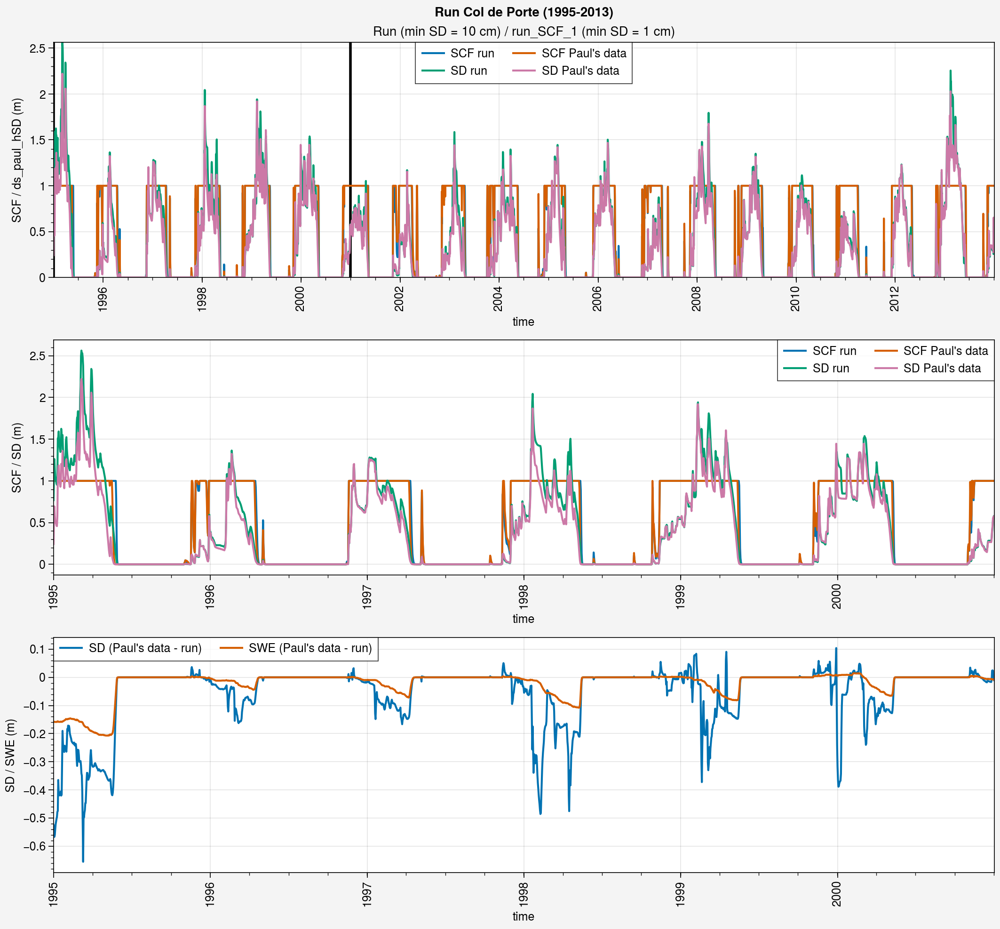

In [22]:
fig, axs = pplt.subplots(ncols=1, nrows=3, refaspect=4, refwidth=10, share=0)

##################
### All period ###
##################
start = '1995'
end = '2013'

axs[0].plot(ds_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label)
axs[0].plot(ds2_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label2)
axs[0].plot(ds_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label)
axs[0].plot(ds2_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label2)

axs[0].legend(ncols=2)
axs[0].format(
    title='Run (min SD = 10 cm) / run_SCF_1 (min SD = 1 cm)',
    ylabel='SCF / ds_paul_hSD (m)'
)


############
### Zoom ###
############
start = '1995'
end = '2000'

axs[1].plot(ds_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label)
axs[1].plot(ds2_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label2)
axs[1].plot(ds_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label)
axs[1].plot(ds2_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label2)
axs[0].vlines(ds_d.sel(time=slice(start,end)).time[0], ds_d.snd.min(), ds_d.snd.max(), color='k', lw=2)
axs[0].vlines(ds_d.sel(time=slice(start,end)).time[-1], ds_d.snd.min(), ds_d.snd.max(), color='k', lw=2)

axs[1].legend(ncols=2)
axs[1].format(
    ylabel='SCF / SD (m)'
)

#####################
### SWE / SD diff ###
#####################
axs[2].plot((ds2_d-ds_d).snd.sel(time=slice(start,end)).squeeze(), label='SD ('+label2+' - '+label+')')
axs[2].plot(((ds2_d-ds_d).snw*1e-3).sel(time=slice(start,end)).squeeze(), label='SWE ('+label2+' - '+label+')')

axs[2].legend(ncols=2)
axs[2].format(
    ylabel='SD / SWE (m)'
)

fig.suptitle('Run Col de Porte (1995-2013)')


## Half hourly outputs

Zoom on the begining of the snow season

Text(0.5, 0.98, 'Col de Porte')

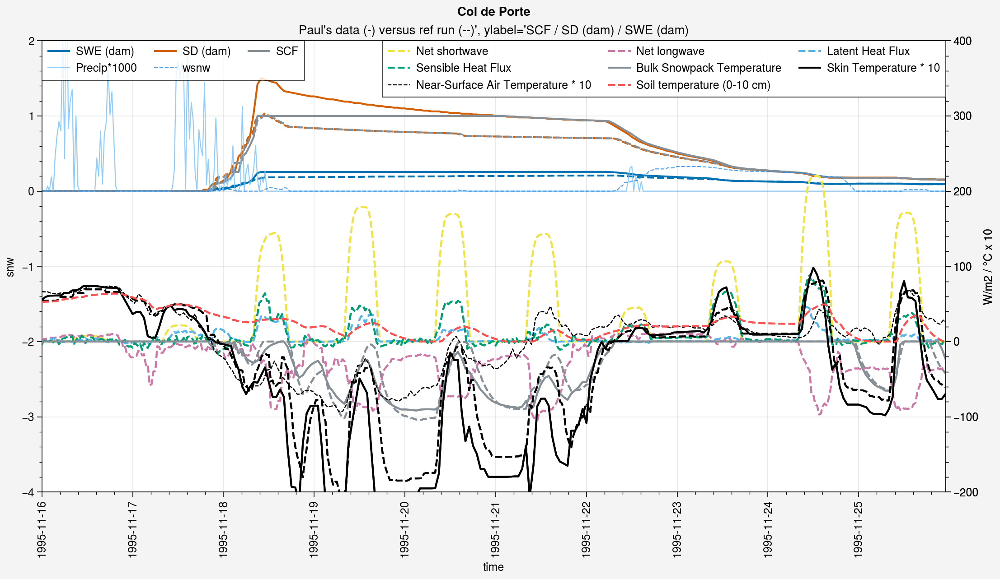

In [63]:
# %matplotlib inline
fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2, refwidth=10)

period4 = slice('1995-11-16','1995-11-25')

h0 = axs[0].plot(ds_paul_h.snw.sel(time=period4).squeeze()*1e-3*20, label='SWE (dam)', color='C0')
axs[0].plot(ds_hh.snw.sel(time=period4).squeeze()*1e-3*20, label='SWE (dam)', color='C0', ls='--')
h1 = axs[0].plot(ds_paul_h.snd.sel(time=period4).squeeze()*10, label='SD (dam)', color='C1')
axs[0].plot(ds_hh.snd.sel(time=period4).squeeze()*10, label='SD (dam)', color='C1', ls='--')
h2 = axs[0].plot(ds_paul_h.snc.sel(time=period4).squeeze(), label='SCF', color='gray6')
axs[0].plot(ds_hh.snc.sel(time=period4).squeeze(), label='SCF', color='gray6', ls='--')
h3 = axs[0].plot(ds_hh.pr.sel(time=period4).squeeze()*1e3, label='Precip*1000', color='blue3', alpha=0.8, lw=0.8)
# h4 = axs[0].plot(ds_paul_h.wsnw.sel(time=period4).squeeze(), label='wsnw', color='blue6', alpha=0.8, lw=0.8)
h4 = axs[0].plot(ds_hh.wsnw.sel(time=period4).squeeze(), label='wsnw', color='blue6', alpha=0.8, lw=0.8, ls='--')


ox = axs[0].alty(label='W/m2 / °C x 10')
# h5 = ox.plot(ds_paul_h.rss.sel(time=period4).squeeze(), label='Net shortwave', color='C4')
h5 = ox.plot(ds_hh.rss.sel(time=period4).squeeze(), label='Net shortwave', color='C4', ls='--')
# h6 = ox.plot(ds_paul_h.rls.sel(time=period4).squeeze(), label='Net longwave', color='C3')
h6 = ox.plot(ds_hh.rls.sel(time=period4).squeeze(), label='Net longwave', color='C3', ls='--')
# h7 = ox.plot(ds_paul_h.hfls.sel(time=period4).squeeze(), label='Latent Heat Flux', color='C5')
h7 = ox.plot(ds_hh.hfls.sel(time=period4).squeeze(), label='Latent Heat Flux', color='C5', ls='--')
# h8 = ox.plot(ds_paul_h.hfss.sel(time=period4).squeeze(), label='Sensible Heat Flux', color='C2')
h8 = ox.plot(ds_hh.hfss.sel(time=period4).squeeze(), label='Sensible Heat Flux', color='C2', ls='--')
h9 = ox.plot((ds_paul_h.tsn.sel(time=period4).squeeze()-273.15)*10, label='Bulk Snowpack Temperature', color='gray6')
ox.plot(ds_hh.tsn.sel(time=period4).squeeze()*10, label='Bulk Snowpack Temperature', color='gray6', ls='--')
h10 = ox.plot((ds_paul_h.ts.sel(time=period4).squeeze()-273.15)*10, label='Skin Temperature * 10', color='k')
ox.plot((ds_hh.ts.sel(time=period4).squeeze()-273.15)*10, label='Skin Temperature * 10', color='k', ls='--')

h11 = ox.plot((ds_hh.tas.sel(time=period4).squeeze()-273.15)*10, label='Near-Surface Air Temperature * 10', color='k', ls='--', lw=0.8)

# h12 = ox.plot((ds_paul_h.tsl.sel(layer=1, time=period4).squeeze()-273.15)*10, label='Soil temperature (0-10 cm)', color='red6')
h12 = ox.plot((ds_hh.tsl.sel(layer=1, time=period4).squeeze()-273.15)*10, label='Soil temperature (0-10 cm)', color='red6', ls='--')


ox.legend([h5, h6, h7, h8, h9, h10, h11, h12], loc='ur')
axs[0].legend([h0, h1, h2, h3, h4], loc='ul')
axs[0].format(title="Paul's data (-) versus ref run (--)', ylabel='SCF / SD (dam) / SWE (dam)")
ox.format(ylim=(-200, 400))
axs[0].format(ylim=(-4, 2))

fig.suptitle('Col de Porte')


## Half hourly outputs 1999

Zoom on the begining of the snow season

Text(0.5, 0.98, 'Col de Porte')

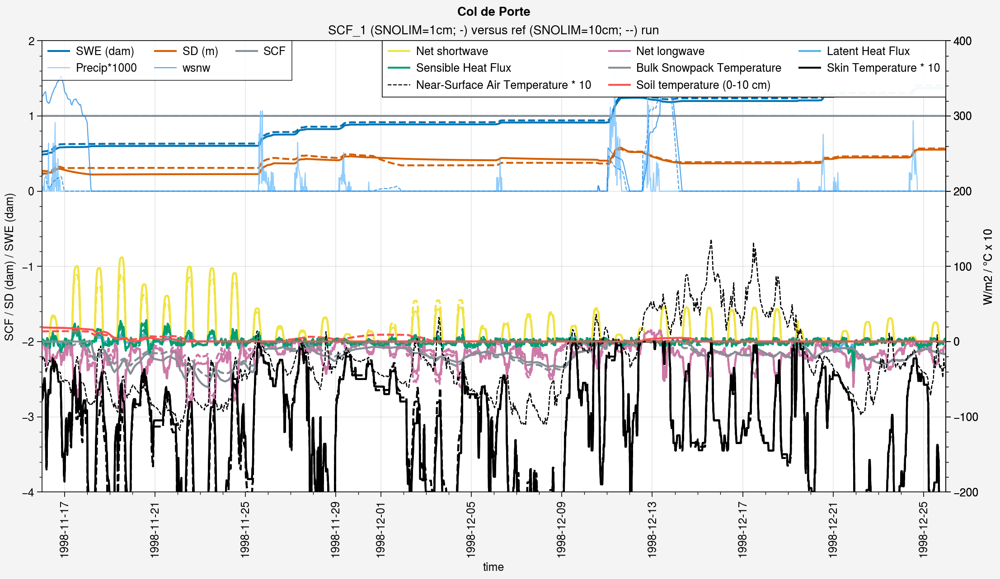

In [21]:
# %matplotlib inline
fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2, refwidth=10)

period4 = slice('1998-11-16','1998-12-25')

h0 = axs[0].plot(ds_paul_h.snw.sel(time=period4).squeeze()*1e-3*10, label='SWE (dam)', color='C0')
axs[0].plot(ds_hh.snw.sel(time=period4).squeeze()*1e-3*10, label='SWE (dam)', color='C0', ls='--')
h1 = axs[0].plot(ds_paul_h.snd.sel(time=period4).squeeze(), label='SD (m)', color='C1')
axs[0].plot(ds_hh.snd.sel(time=period4).squeeze(), label='SD (m)', color='C1', ls='--')
h2 = axs[0].plot(ds_paul_h.snc.sel(time=period4).squeeze(), label='SCF', color='gray6')
axs[0].plot(ds_hh.snc.sel(time=period4).squeeze(), label='SCF', color='gray6', ls='--')
h3 = axs[0].plot(ds_hh.pr.sel(time=period4).squeeze()*1e3, label='Precip*1000', color='blue3', alpha=0.8, lw=0.8)
h4 = axs[0].plot(ds_paul_h.wsnw.sel(time=period4).squeeze(), label='wsnw', color='blue6', alpha=0.8, lw=0.8)
axs[0].plot(ds_hh.wsnw.sel(time=period4).squeeze(), label='wsnw', color='blue6', alpha=0.8, lw=0.8, ls='--')


ox = axs[0].alty(label='W/m2 / °C x 10')
h5 = ox.plot(ds_paul_h.rss.sel(time=period4).squeeze(), label='Net shortwave', color='C4')
ox.plot(ds_hh.rss.sel(time=period4).squeeze(), label='Net shortwave', color='C4', ls='--')
h6 = ox.plot(ds_paul_h.rls.sel(time=period4).squeeze(), label='Net longwave', color='C3')
ox.plot(ds_hh.rls.sel(time=period4).squeeze(), label='Net longwave', color='C3', ls='--')
h7 = ox.plot(ds_paul_h.hfls.sel(time=period4).squeeze(), label='Latent Heat Flux', color='C5')
ox.plot(ds_hh.hfls.sel(time=period4).squeeze(), label='Latent Heat Flux', color='C5', ls='--')
h8 = ox.plot(ds_paul_h.hfss.sel(time=period4).squeeze(), label='Sensible Heat Flux', color='C2')
ox.plot(ds_hh.hfss.sel(time=period4).squeeze(), label='Sensible Heat Flux', color='C2', ls='--')
h9 = ox.plot(ds_paul_h.tsn.sel(time=period4).squeeze()*10, label='Bulk Snowpack Temperature', color='gray6')
ox.plot(ds_hh.tsn.sel(time=period4).squeeze()*10, label='Bulk Snowpack Temperature', color='gray6', ls='--')
h10 = ox.plot((ds_paul_h.ts.sel(time=period4).squeeze()-273.15)*10, label='Skin Temperature * 10', color='k')
ox.plot((ds_hh.ts.sel(time=period4).squeeze()-273.15)*10, label='Skin Temperature * 10', color='k', ls='--')

h11 = ox.plot((ds_hh.tas.sel(time=period4).squeeze()-273.15)*10, label='Near-Surface Air Temperature * 10', color='k', ls='--', lw=0.8)

h12 = ox.plot((ds_paul_h.tsl.sel(layer=1, time=period4).squeeze()-273.15)*10, label='Soil temperature (0-10 cm)', color='red6')
ox.plot((ds_hh.tsl.sel(layer=1, time=period4).squeeze()-273.15)*10, label='Soil temperature (0-10 cm)', color='red6', ls='--')


ox.legend([h5, h6, h7, h8, h9, h10, h11, h12], loc='ur')
axs[0].legend([h0, h1, h2, h3, h4], loc='ul')
axs[0].format(title='SCF_1 (SNOLIM=1cm; -) versus ref (SNOLIM=10cm; --) run', ylabel='SCF / SD (dam) / SWE (dam)')
ox.format(ylim=(-200, 400))
axs[0].format(ylim=(-4, 2))

fig.suptitle('Col de Porte')


## Compare with obs

In [64]:
path_menard2019 = '/home/lalandmi/Dropbox/data/ESM-SnowMIP_all'
path_lejeune2019 = '/home/lalandmi/Dropbox/data/ESM-SnowMIP_all/CRYOBSCLIM_CDP'

ds_h_eval_menard2019 = xr.open_dataset(path_menard2019+'/obs_insitu_cdp_1994_2014.nc').load()
ds_d_eval_menard2019 = ds_h_eval_menard2019.resample(time='D').mean().load()
ds_h_eval_menard2019

<xarray.Dataset>
Dimensions:   (time: 175320, sdepth: 3)
Coordinates:
  * time      (time) datetime64[ns] 1994-10-01T01:00:00 ... 2014-10-01
  * sdepth    (sdepth) float32 0.1 0.2 0.5
Data variables:
    albs      (time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    snd_auto  (time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    snd_man   (time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    snw_auto  (time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    snw_man   (time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    ts        (time) float32 11.12 9.668 8.029 0.9937 ... 7.532 7.532 8.029
    tsl       (time, sdepth) float32 11.95 12.28 12.23 11.8 ... 12.95 12.83 12.8

In [65]:
ds_h_eval_lejeune2019 = xr.open_dataset(path_lejeune2019+'/CRYOBSCLIM.CDP.2018.HourlySnow.nc').load()
ds_d_eval_lejeune2019 = xr.open_dataset(path_lejeune2019+'/CRYOBSCLIM.CDP.2018.MetSnowDaily.nc').load()
ds_h_eval_lejeune2019

<xarray.Dataset>
Dimensions:                   (time: 254208)
Coordinates:
  * time                      (time) datetime64[ns] 1993-08-01 ... 2022-07-31...
Data variables: (12/70)
    Soil_temperature_10cm     (time) float64 289.9 289.7 289.5 ... 292.2 291.9
    Soil_temperature_20cm     (time) float64 290.1 290.0 289.9 ... 291.6 291.6
    Soil_temperature_50cm     (time) float64 288.6 288.6 288.7 ... 290.1 290.2
    Runoff_5m2                (time) float64 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Runoff_1m2                (time) float64 0.2 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Snow_depth                (time) float64 nan nan nan nan ... 0.0 0.0 0.0 0.0
    ...                        ...
    Soil_moisture_10cm_2      (time) float64 nan nan nan ... 0.1284 0.128 0.1279
    Soil_moisture_10cm_3      (time) float64 nan nan nan ... 0.0606 0.0624
    Soil_moisture_20cm_1      (time) float64 nan nan nan ... 0.2251 0.2251 0.225
    Soil_moisture_20cm_2      (time) float64 nan nan nan ... 0.2104 0.2102 0.21
    Soil_moisture_30cm_1      (time) float64 nan nan nan ... 0.2498 0.2497
    Soil_moisture_30cm_2      (time) float64 nan nan nan ... 0.2918 0.2915
Attributes:
    history:  Thu Feb  9 11:25:20 2023: ncrcat CDP_hourly_19930801_20170731.n...
    NCO:      netCDF Operators version 4.9.1 (Homepage = http://nco.sf.net, C...

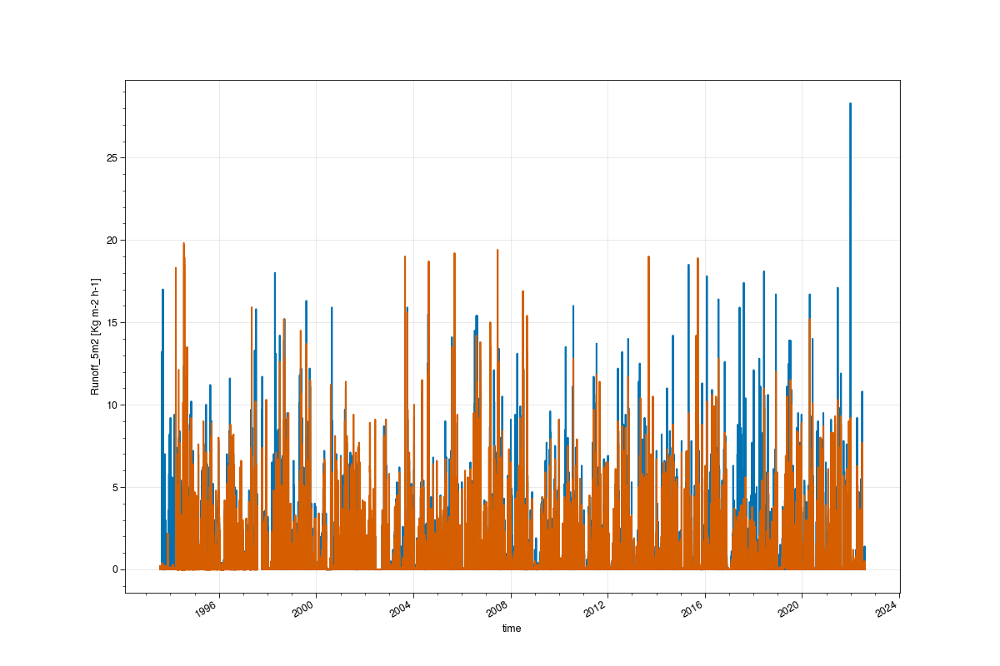

In [612]:
%matplotlib widget
ds_h_eval_lejeune2019['Runoff_1m2'].plot(figsize=(12,8))
ds_h_eval_lejeune2019['Runoff_5m2'].plot()

### SD

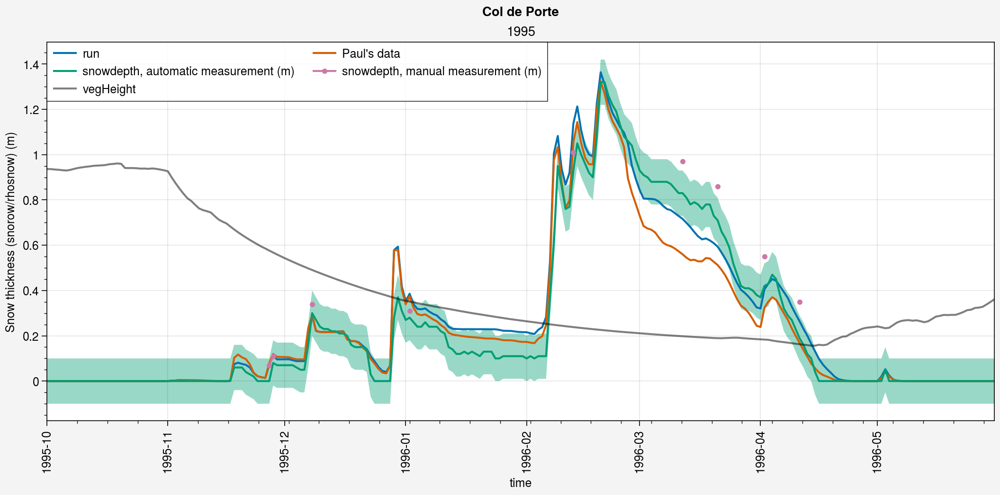

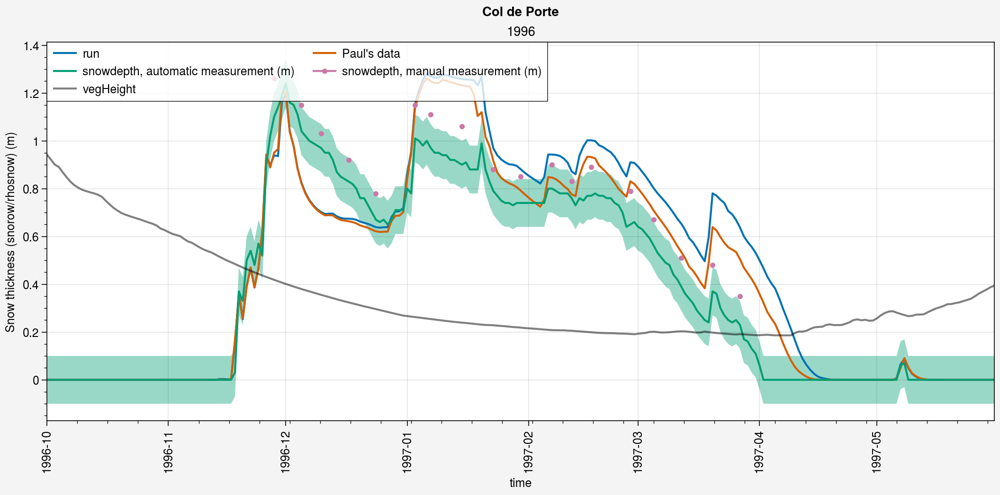

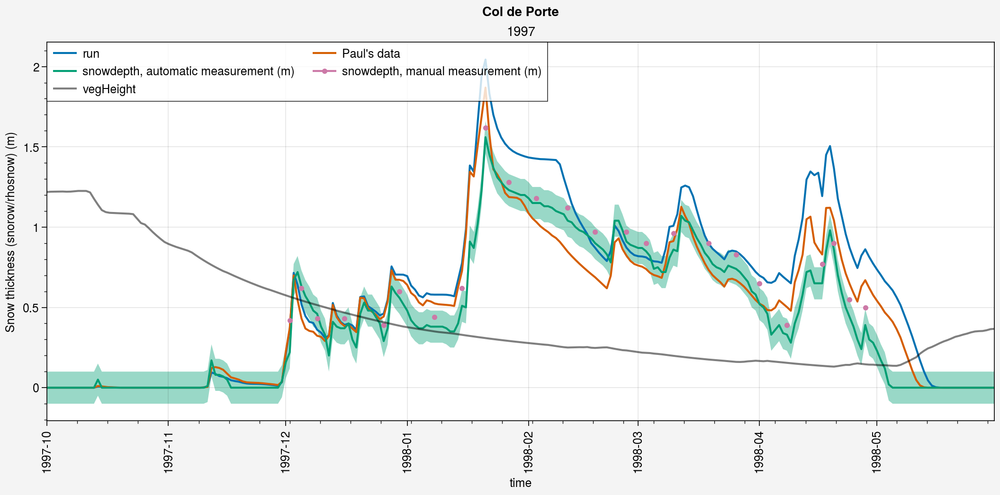

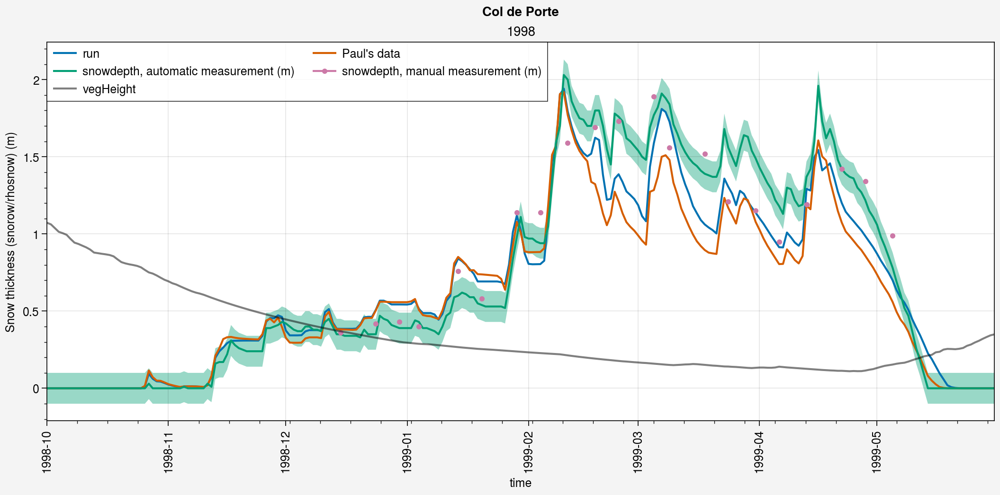

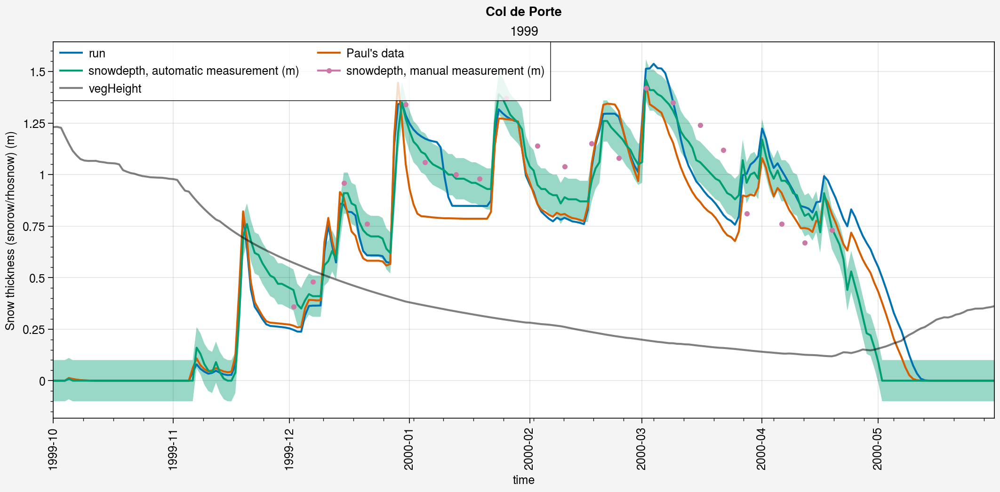

...

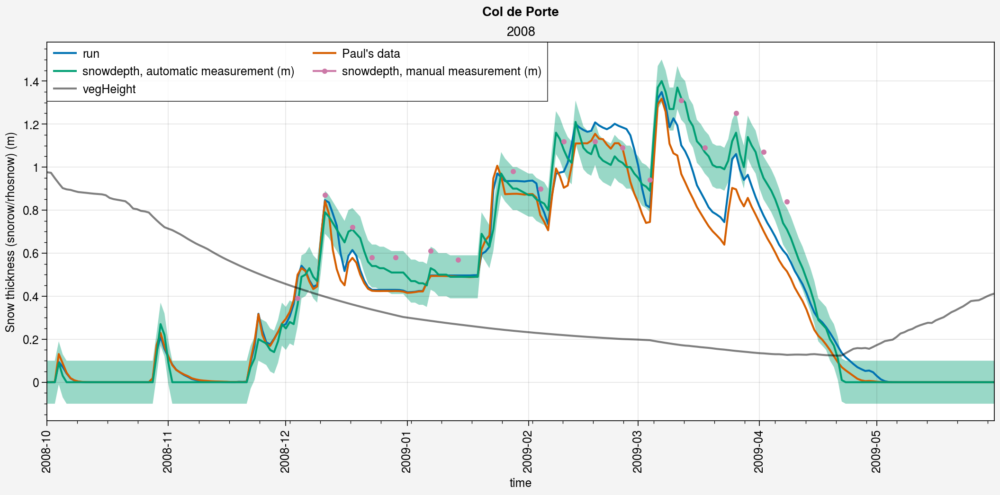

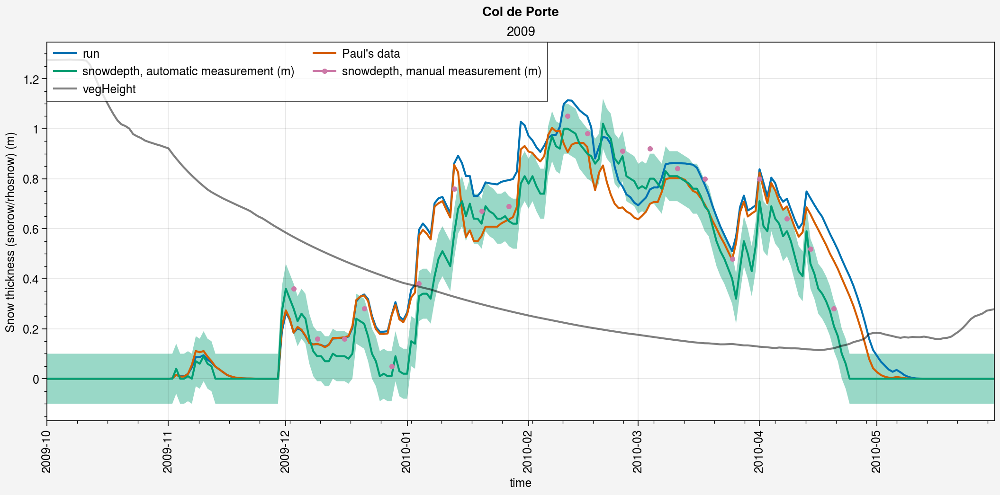

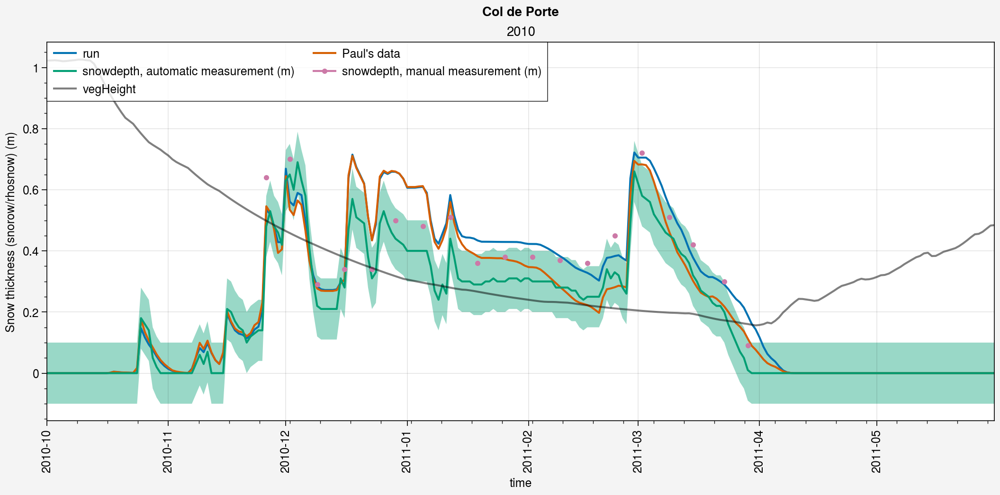

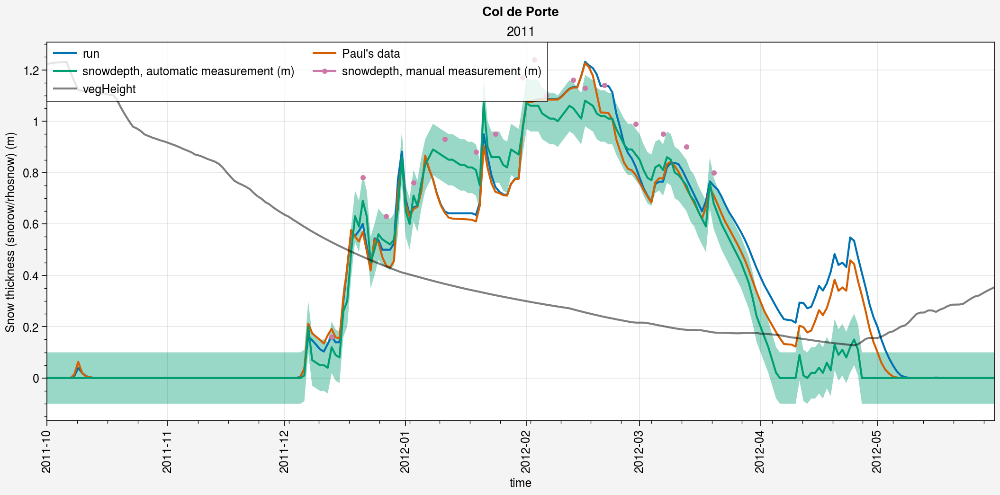

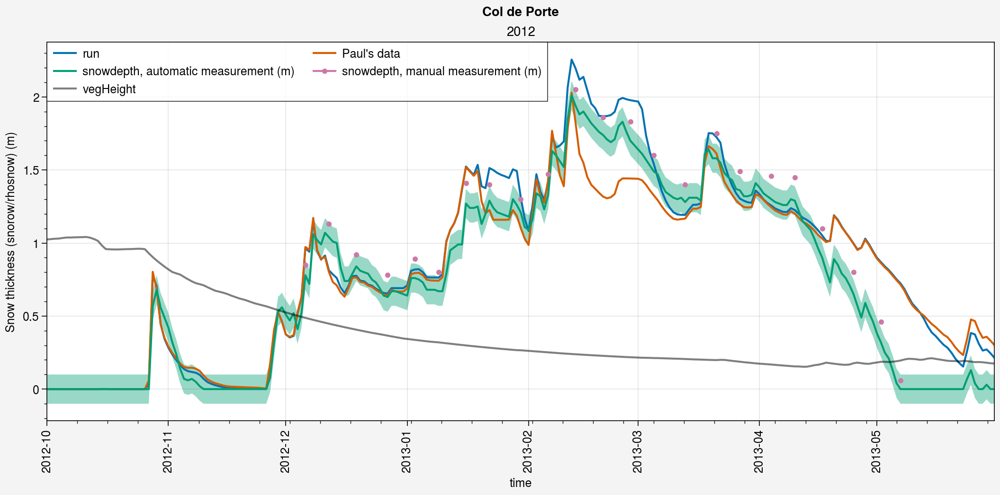

In [67]:
%matplotlib inline
for year in pplt.arange(1995, 2012):
# for year in pplt.arange(1995, 1995):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.snd.sel(time=period).squeeze(), label=label)
    axs[0].plot(ds2_d.snd.sel(time=period).squeeze(), label=label2)
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values+0.1, axis=0),
        np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values-0.1, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.snd_auto.sel(time=period), shadedata=shadedata)
    axs[0].plot(ds_d_eval_menard2019.snd_man.sel(time=period), marker='.')

    # Veg
    axs[0].plot(ds_d.vegHeight.sel(time=period).squeeze(), label='vegHeight', color='k', alpha=0.5)
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year))
    
    fig.suptitle('Col de Porte')


### SWE

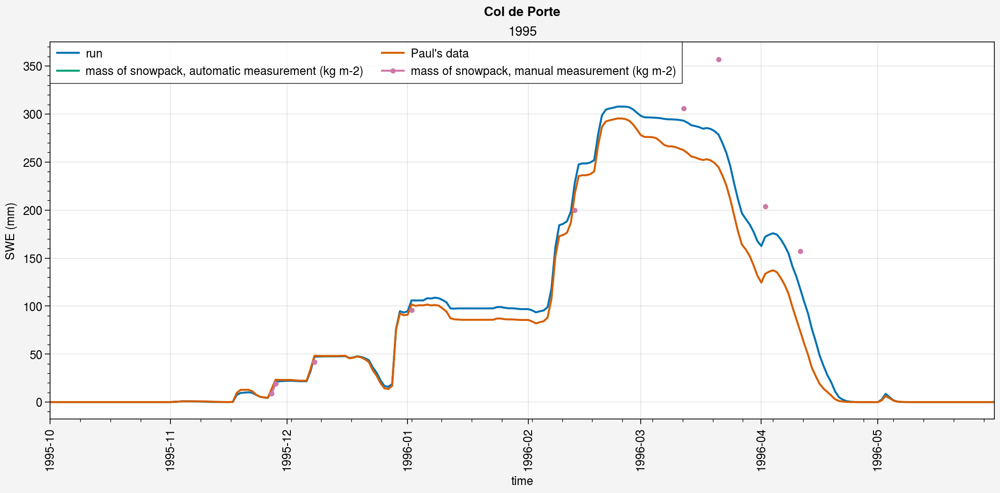

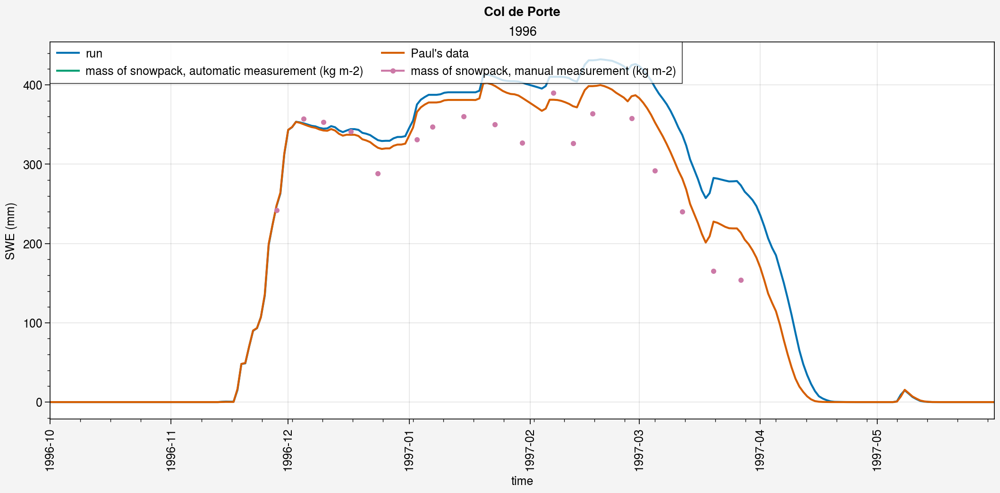

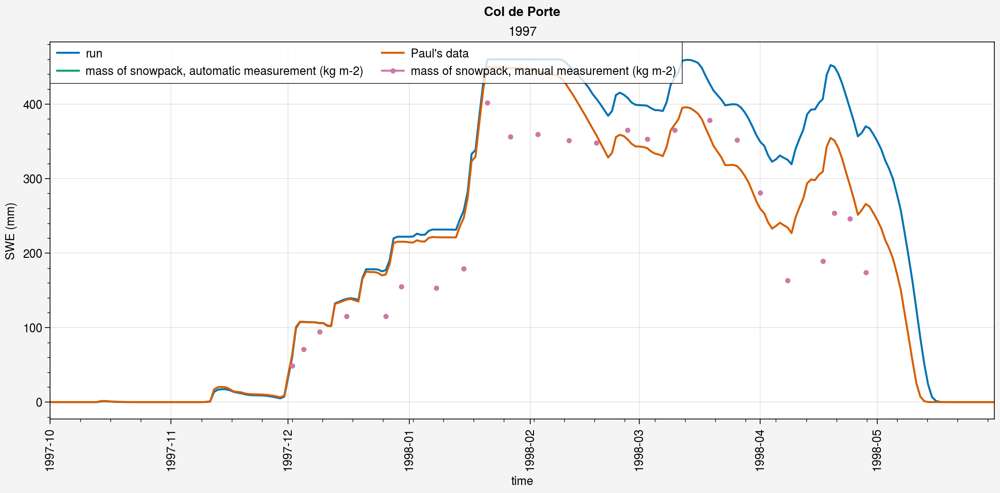

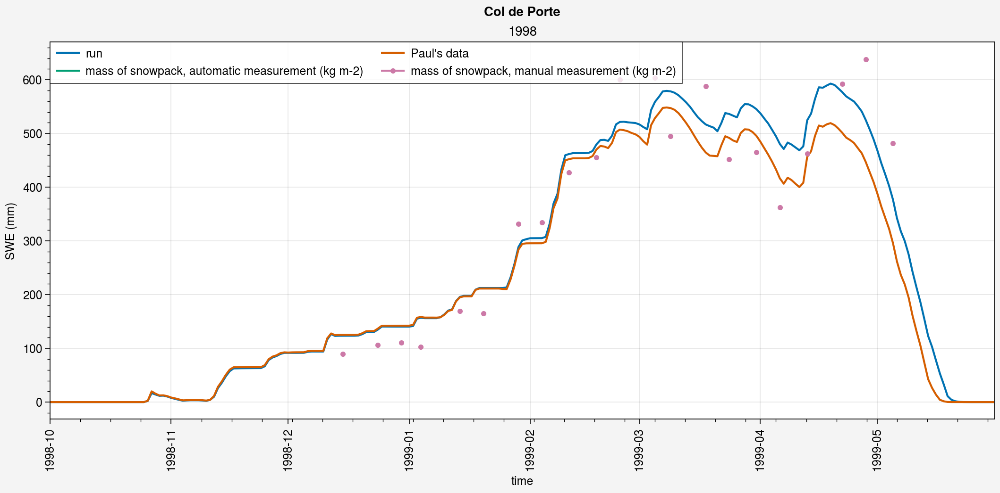

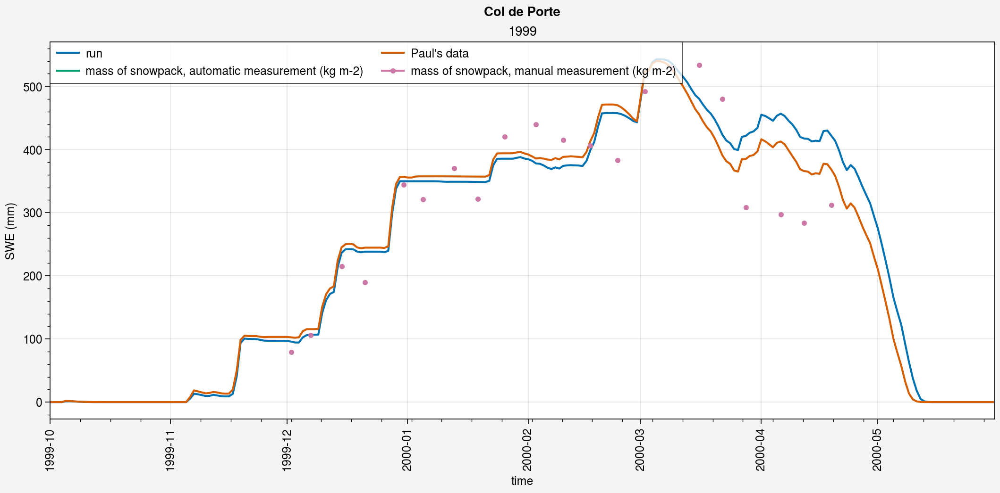

...

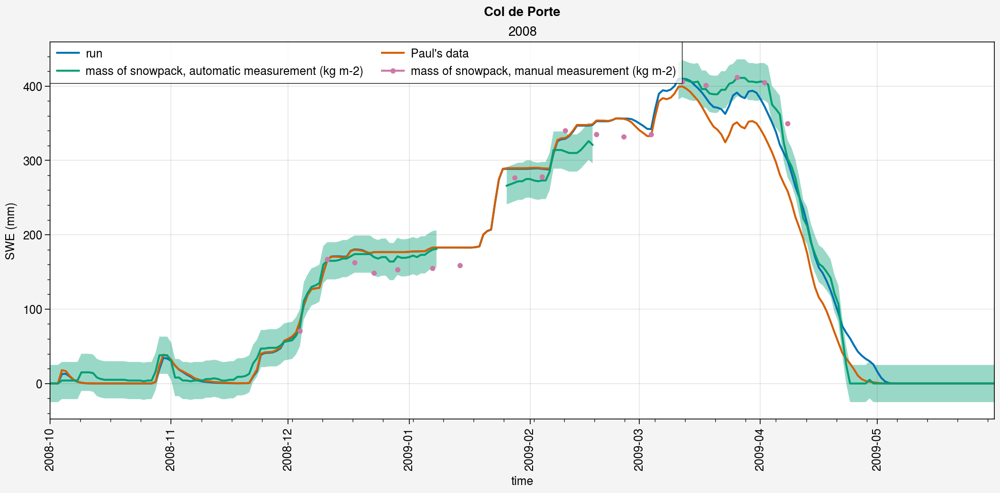

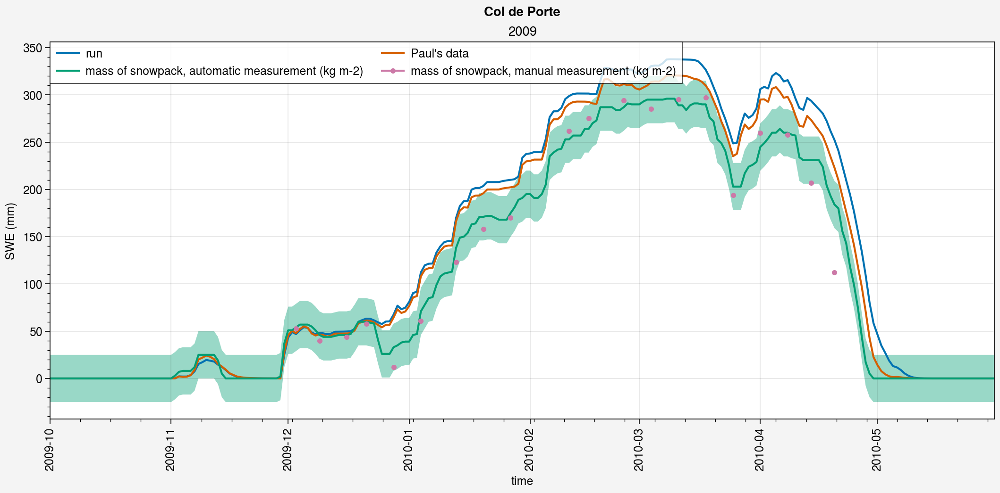

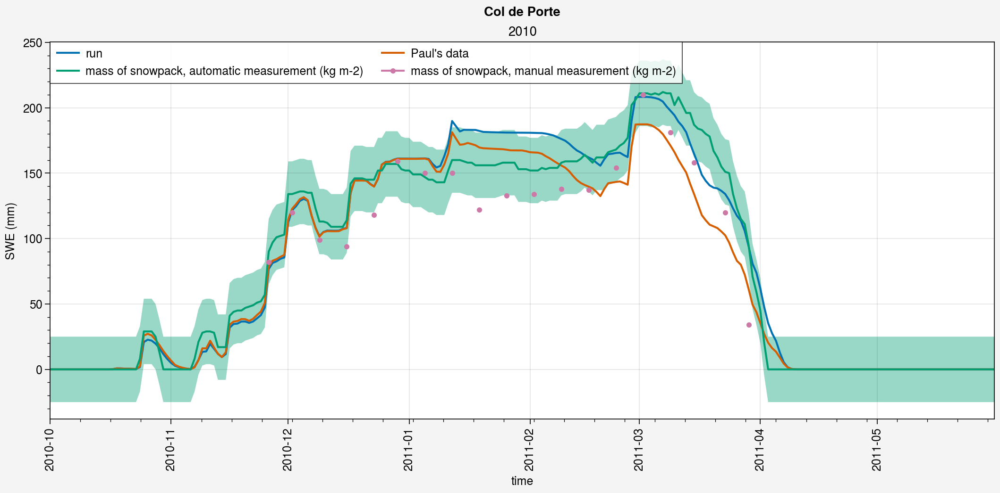

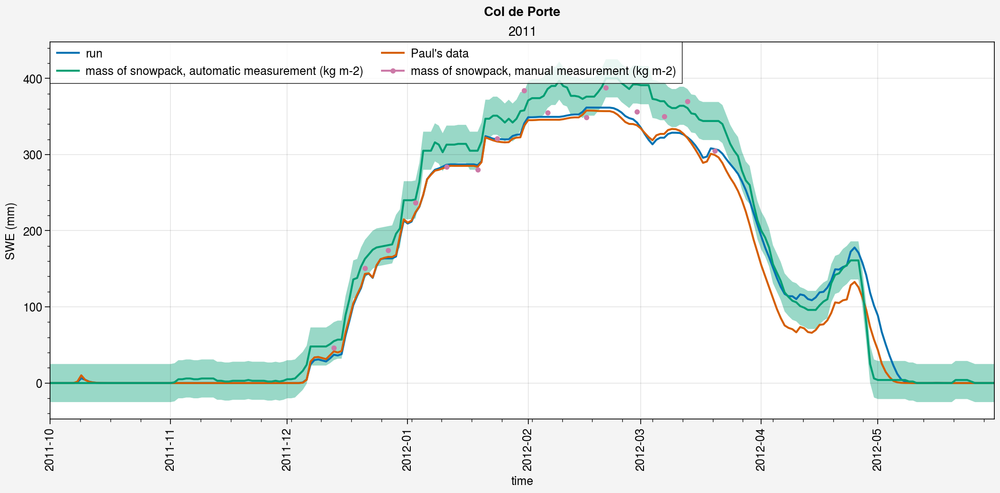

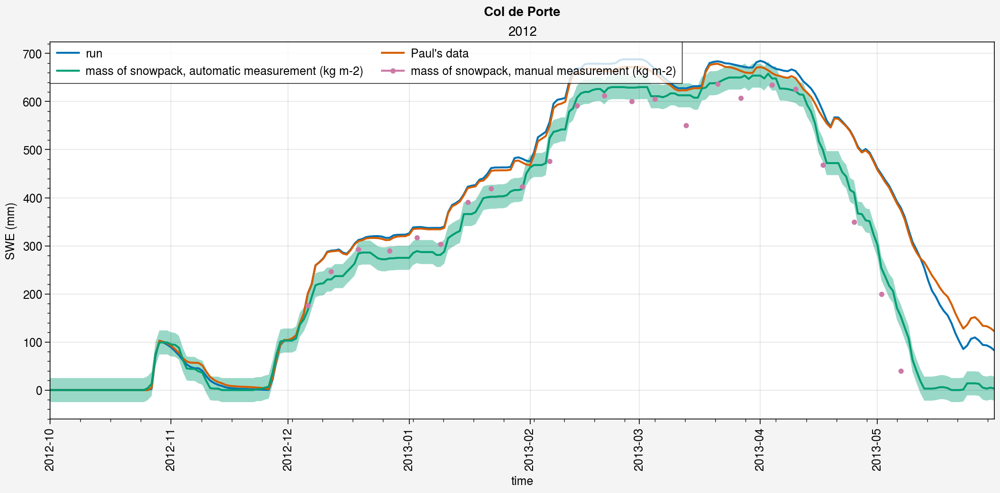

In [68]:
%matplotlib inline
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.snw.sel(time=period).squeeze(), label=label)
    axs[0].plot(ds2_d.snw.sel(time=period).squeeze(), label=label2)
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.snw_auto.sel(time=period).values+25, axis=0),
        np.expand_dims(ds_d_eval_menard2019.snw_auto.sel(time=period).values-25, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.snw_auto.sel(time=period), shadedata=shadedata)
    axs[0].plot(ds_d_eval_menard2019.snw_man.sel(time=period), marker='.')
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='SWE (mm)')
    
    fig.suptitle('Col de Porte')


### Albedo

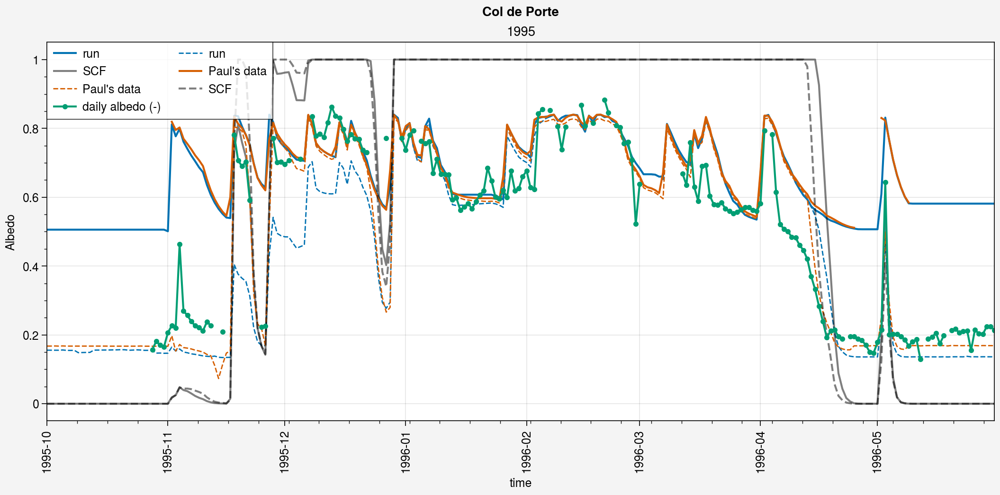

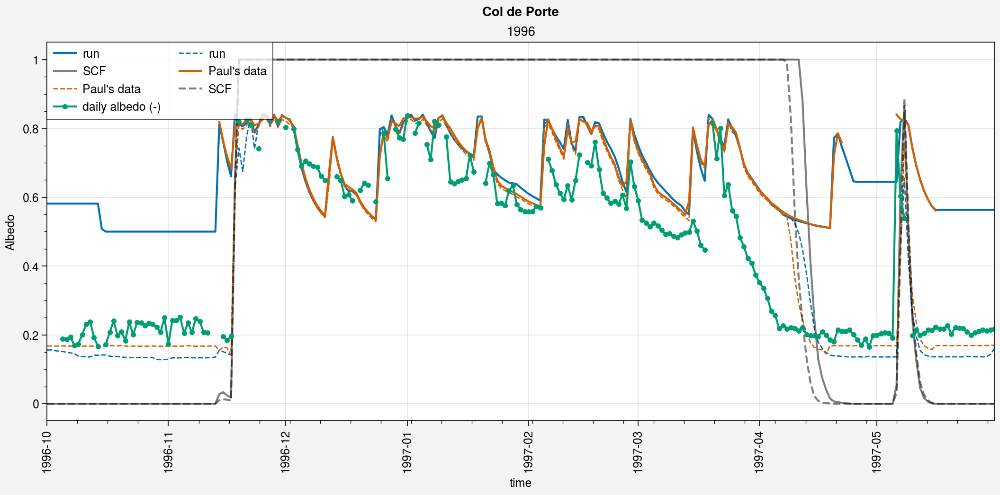

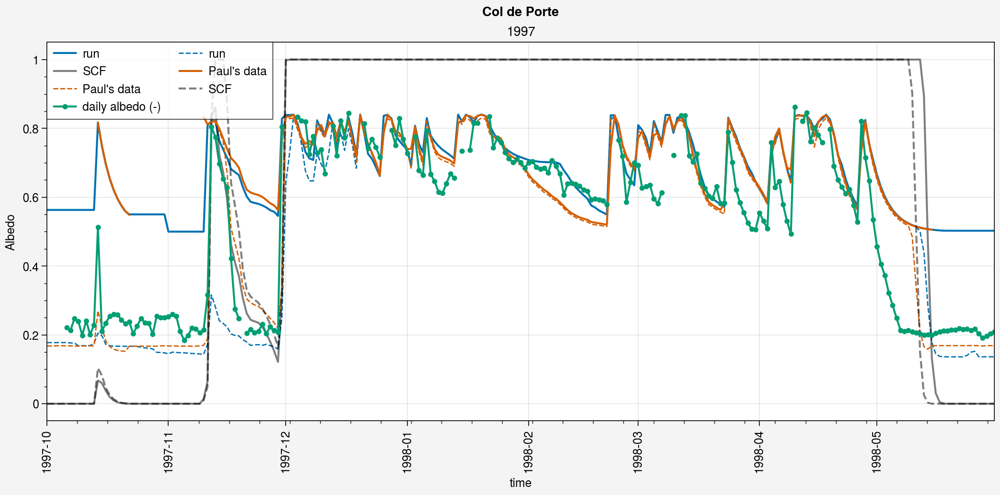

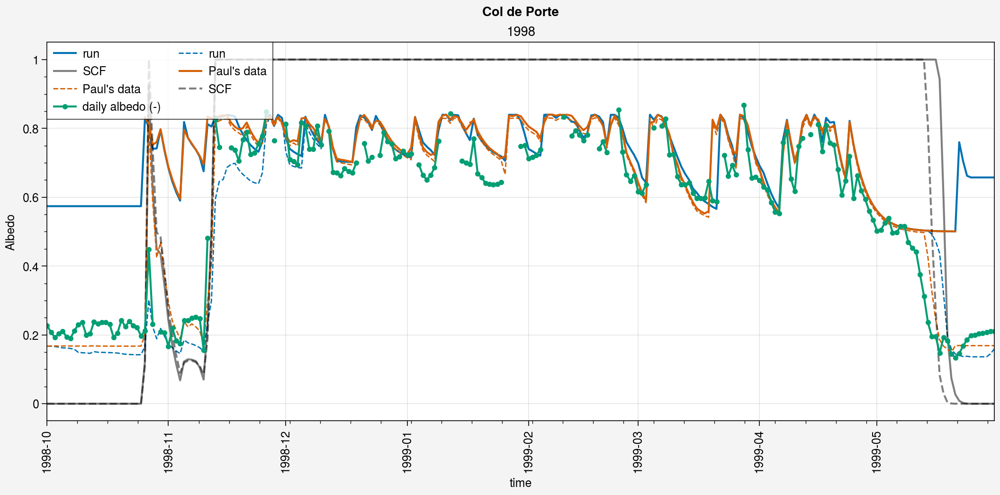

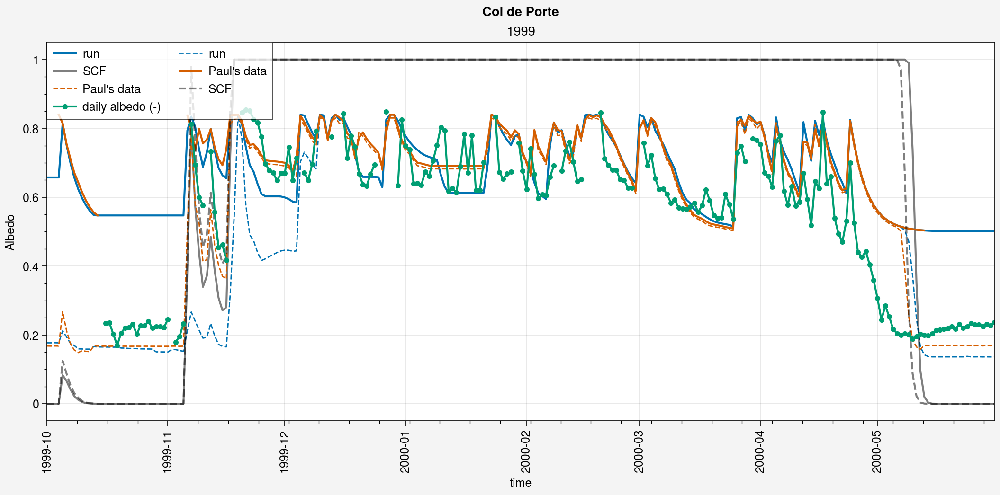

...

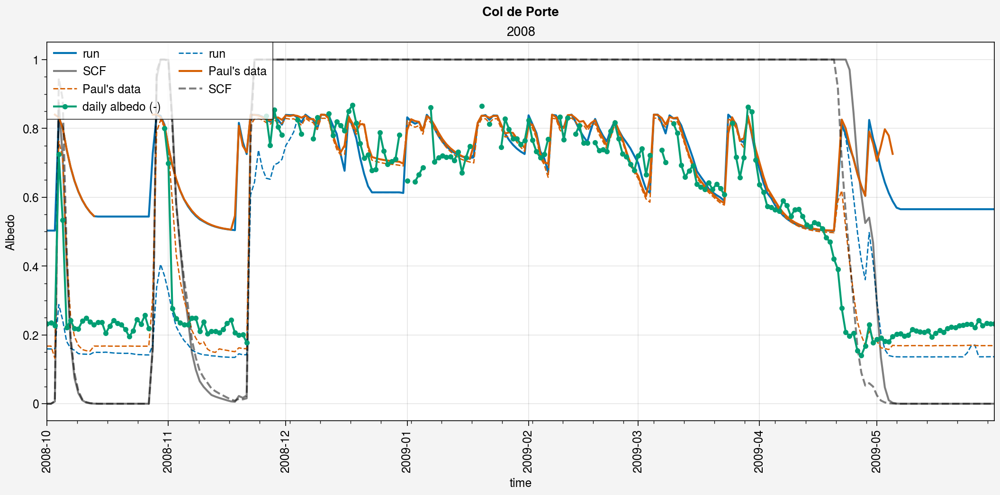

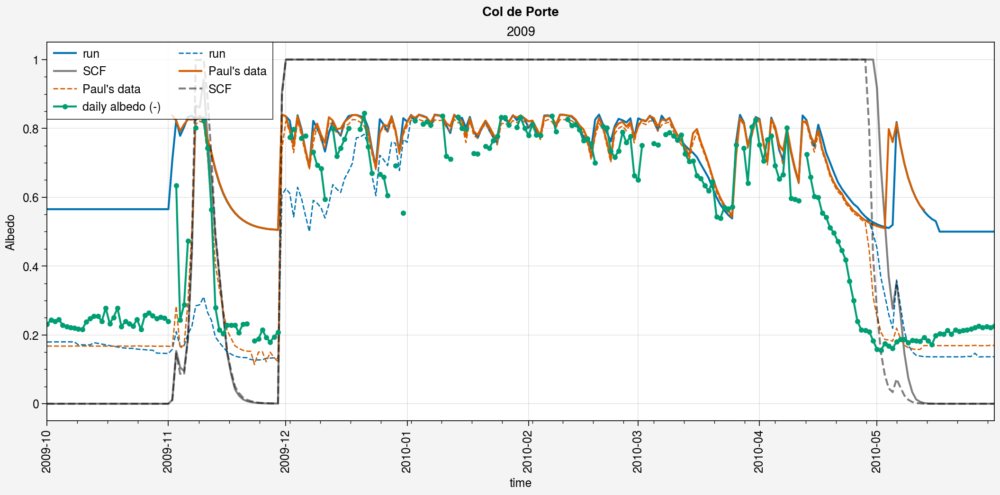

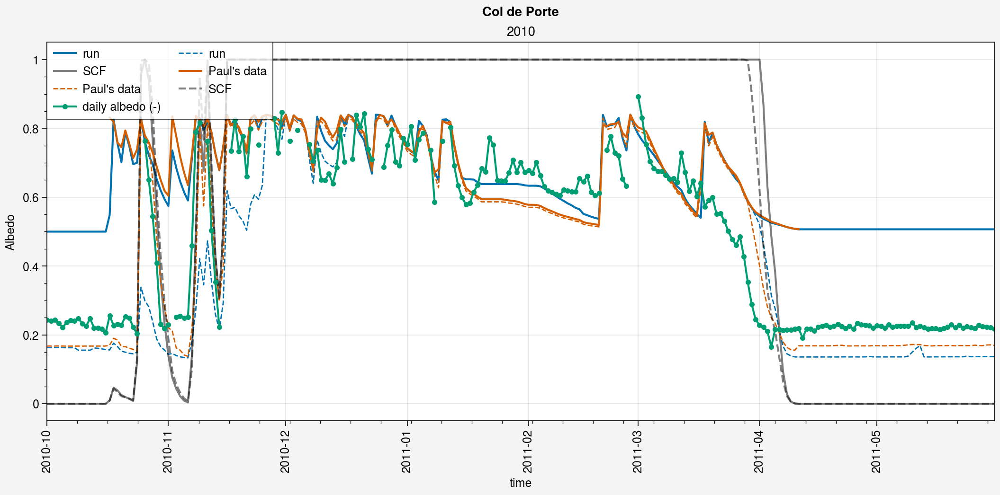

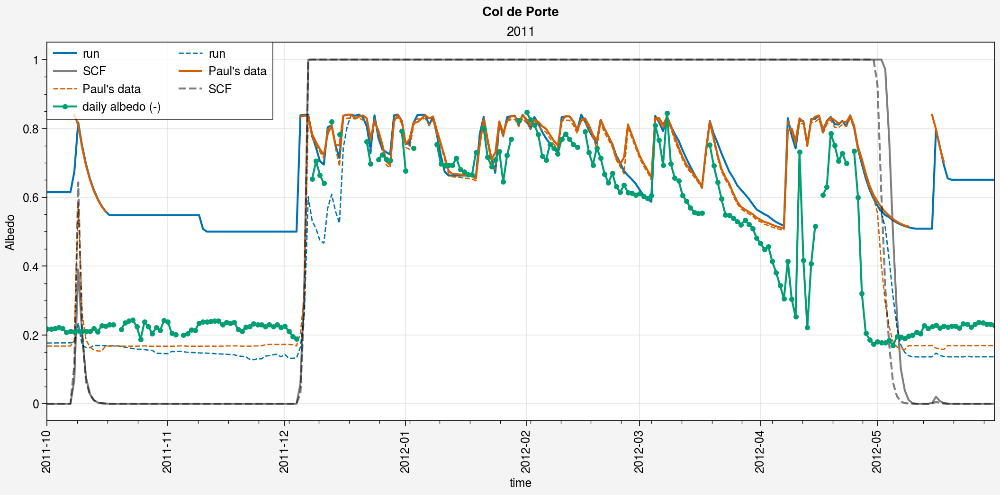

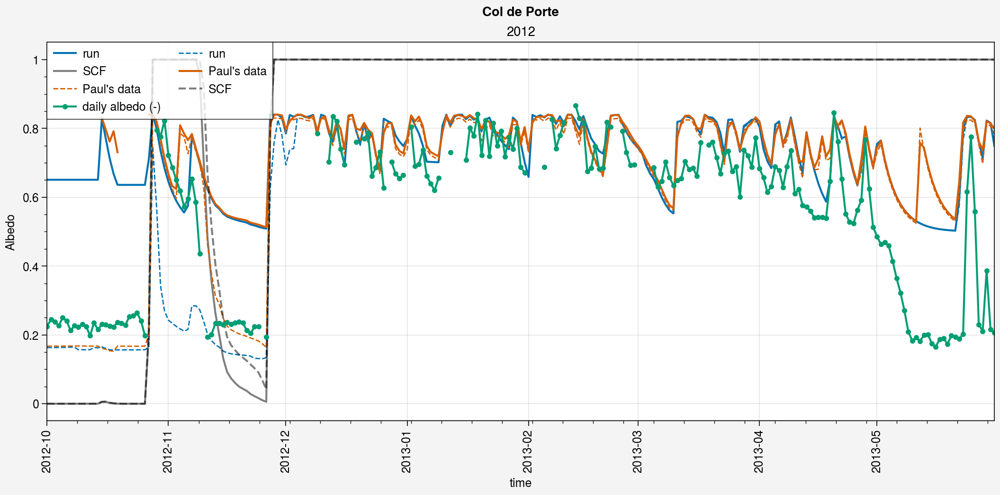

In [69]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.albsn.sel(time=period).squeeze(), label=label, color='C0')
    axs[0].plot(ds_d.albs.sel(time=period).squeeze(), label=label, color='C0', ls='--', lw=1)
    axs[0].plot(ds_d.snc.sel(time=period).squeeze(), label='SCF', color='k', alpha=0.5)
    axs[0].plot(ds2_d.albsn.sel(time=period).squeeze(), label=label2, color='C1')
    axs[0].plot(ds2_d.albs.sel(time=period).squeeze(), label=label2, color='C1', ls='--', lw=1)
    axs[0].plot(ds2_d.snc.sel(time=period).squeeze(), label='SCF', color='k', alpha=0.5, ls='--')
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.albs.sel(time=period), marker='.', color='C2')
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Albedo')
    
    fig.suptitle('Col de Porte')


### Surface Temperature

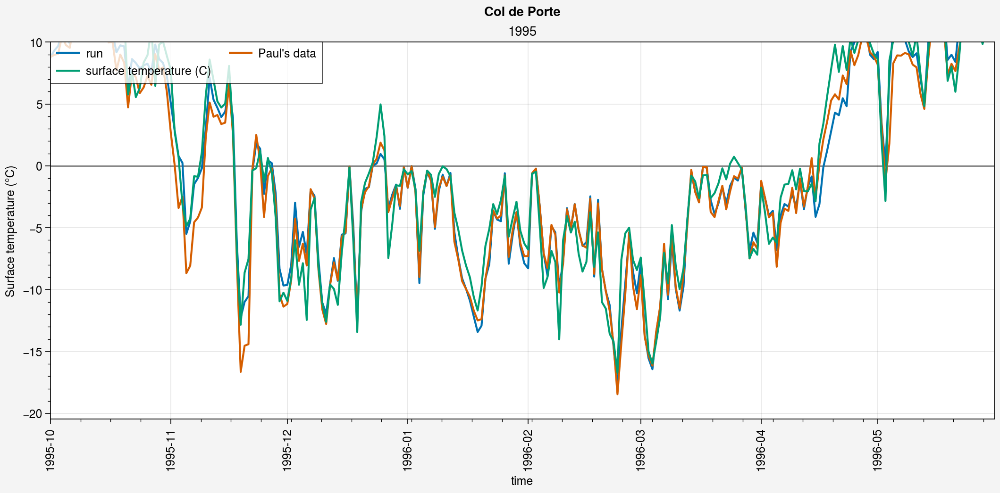

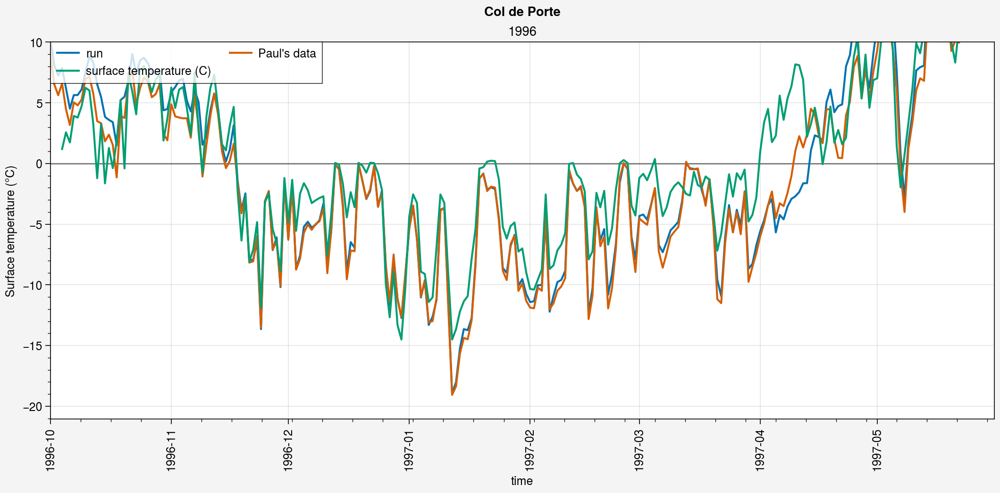

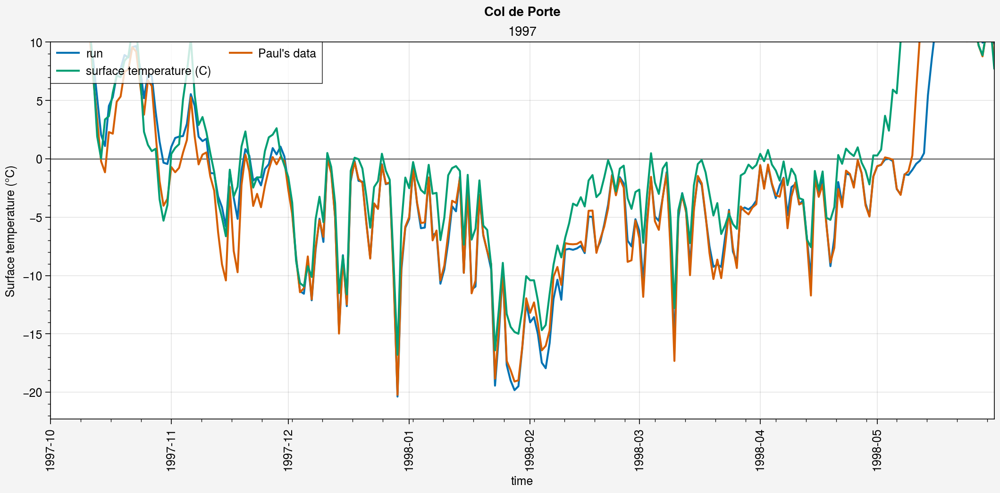

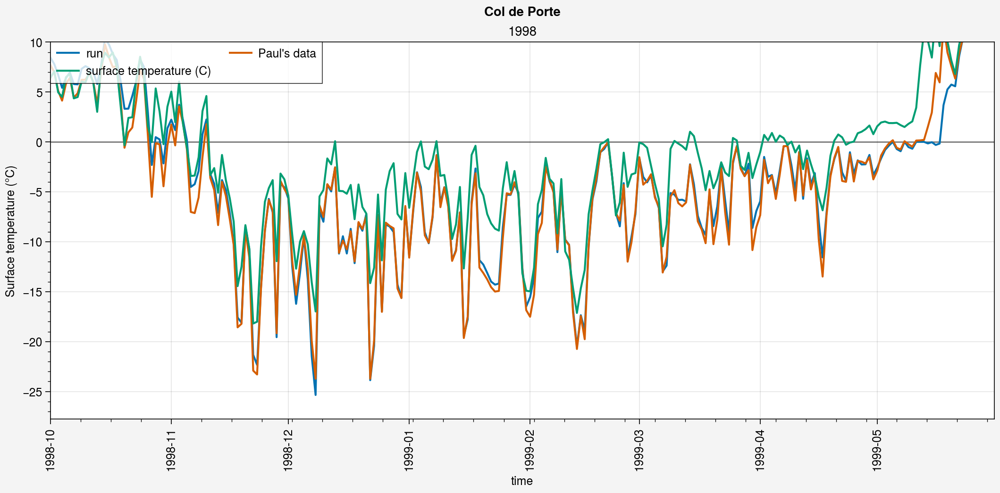

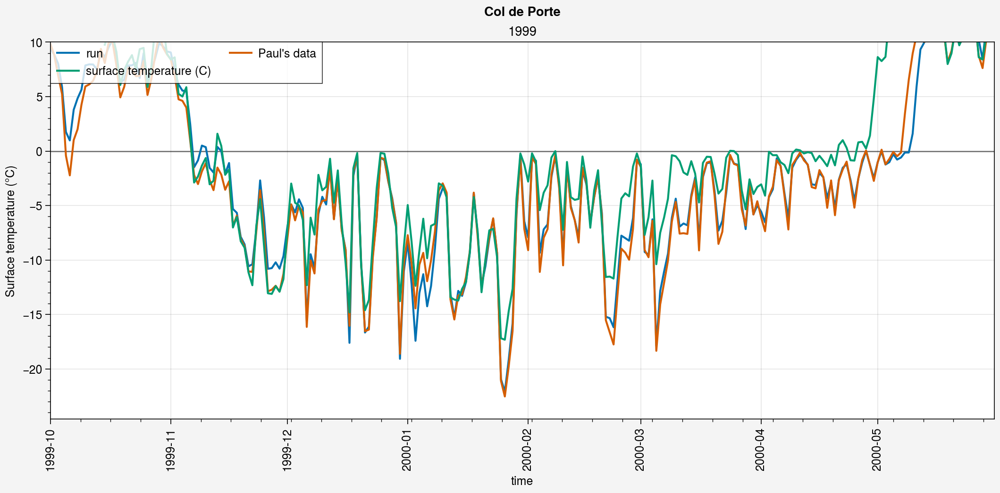

...

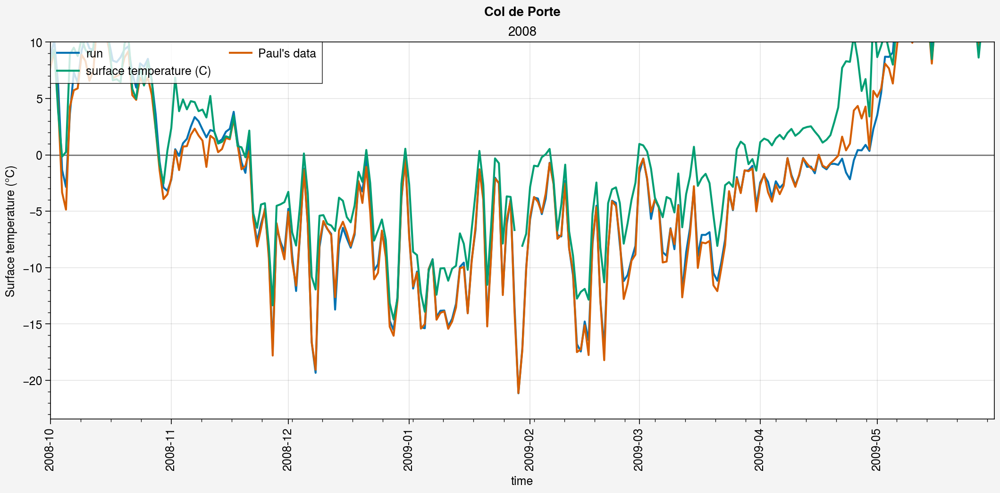

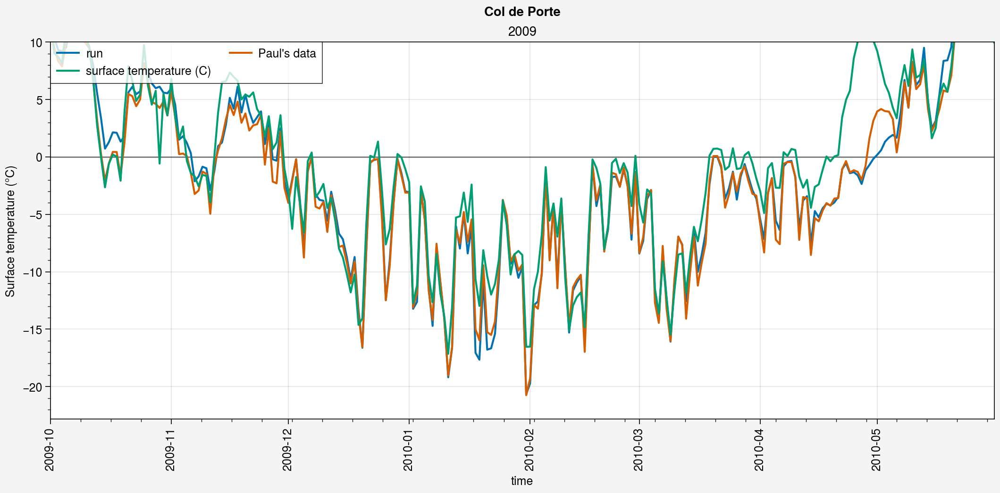

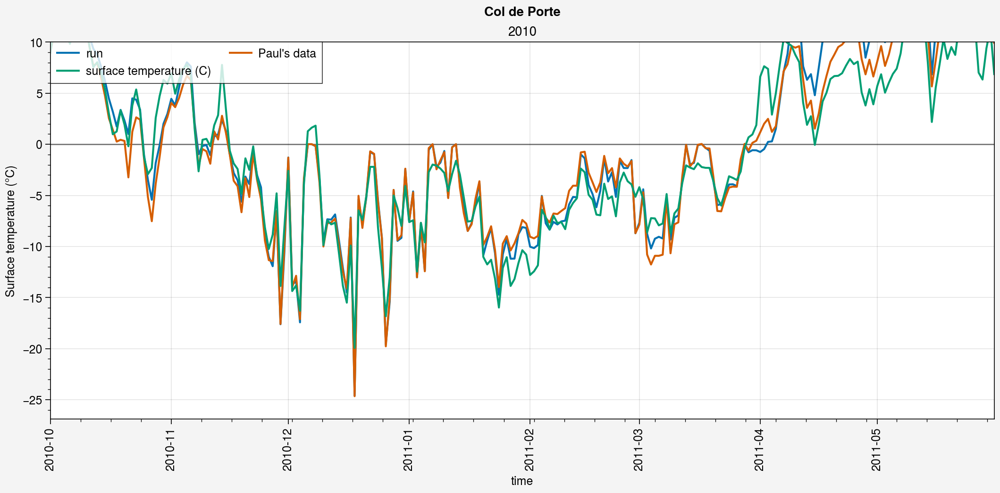

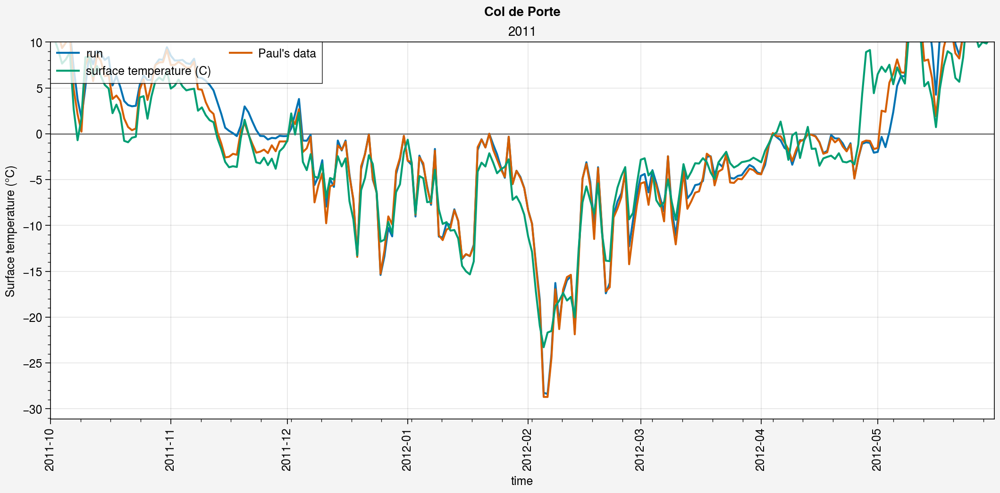

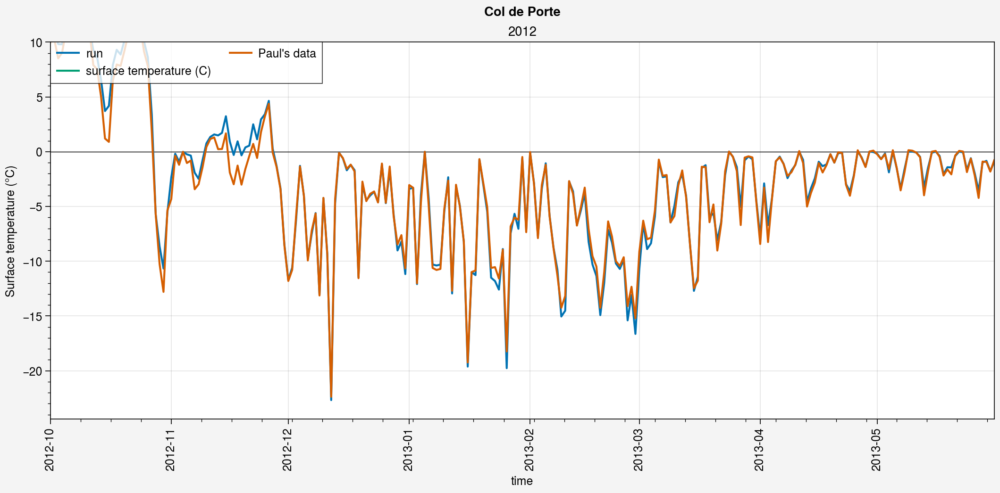

In [71]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.ts.sel(time=period).squeeze()-273.15, label=label)
    axs[0].plot(ds2_d.ts.sel(time=period).squeeze()-273.15, label=label2)
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.ts.sel(time=period))

    axs[0].hlines(0, ds_d.ts.sel(time=period).time[0], ds_d.ts.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Surface temperature (°C)', ymax=10)
    
    fig.suptitle('Col de Porte')


## Annual cycles comparison

/home/lalandmi/miniconda3/envs/sc2_v0/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/home/lalandmi/miniconda3/envs/sc2_v0/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/home/lalandmi/miniconda3/envs/sc2_v0/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/home/lalandmi/miniconda3/envs/sc2_v0/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/home/lalandmi/miniconda3/envs/sc2_v0/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/home/lalandmi/miniconda3/envs/sc2_v0/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-N

Text(0.5, 0.98, 'Col de Porte (1995-2012)')

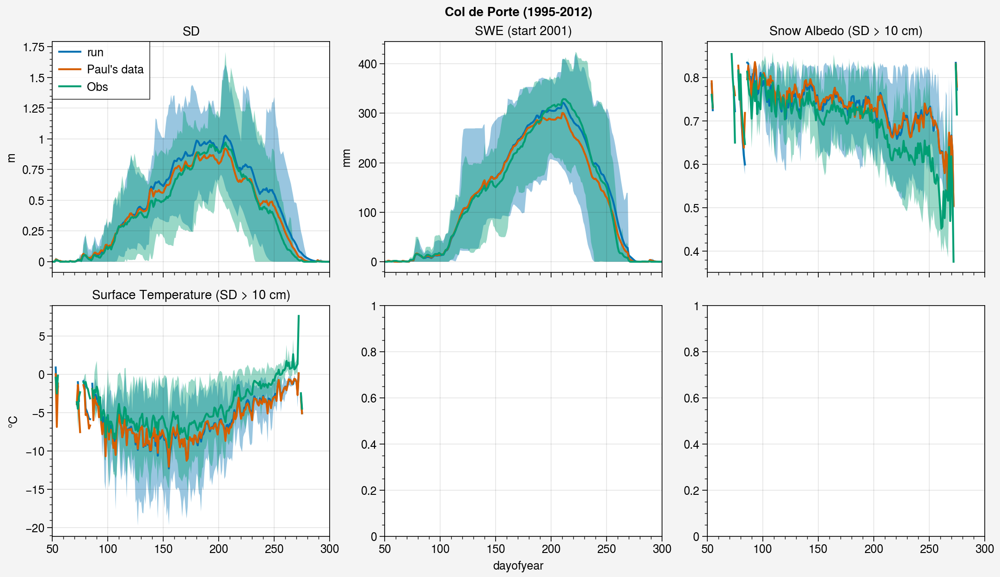

In [72]:
fig, axs = pplt.subplots(ncols=3, nrows=2, refwidth=3, refaspect=1.2, sharey=0)

doy = 140
period = slice('1995', '2012')

ax = axs[0]
mask_obs = ~ds_d_eval_menard2019.snd_auto.sel(time=period).isnull()
shadedata = ds_d.snd.sel(time=period).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
h1 = ax.plot(ds_d.snd.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata, label=label)
h2 = ax.plot(ds2_d.snd.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), label=label2)

shadedata = ds_h_eval_menard2019.snd_auto.sel(time=period).resample(time='D').mean().groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
h3 = ax.plot(ds_h_eval_menard2019.snd_auto.sel(time=period).resample(time='D').mean().groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata, label='Obs')
ax.format(title='SD', ylabel='m')
ax.legend([h1, h2, h3], loc='ul', ncols=1)


ax = axs[1]
mask_obs = ~ds_d_eval_menard2019.snw_auto.sel(time=period).isnull()
shadedata = ds_d.snw.sel(time=period).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d.snw.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.plot(ds2_d.snw.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze())

shadedata = ds_h_eval_menard2019.snw_auto.sel(time=period).resample(time='D').mean().groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_h_eval_menard2019.snw_auto.sel(time=period).resample(time='D').mean().groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='SWE (start 2001)', ylabel='mm')


ax = axs[2]
mask_obs = ~ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ds_d.albsn.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d.albsn.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.plot(ds2_d.albsn.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze())

shadedata = ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Snow Albedo (SD > 10 cm)', ylabel='')


ax = axs[3]
mask_obs = ~ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ds_d.ts.where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')-273.15
ax.plot(ds_d.ts.where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15, shadedata=shadedata)
ax.plot(ds2_d.ts.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15)

shadedata = ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Surface Temperature (SD > 10 cm)', ylabel='°C')


for ax in axs:
    ax.format(xlim=(50,300))

fig.suptitle('Col de Porte ('+period.start+'-'+period.stop+')')




## Time series

In [73]:
def mb(simu, obs):
    return (simu-obs).mean().values.item(0)

def rmb(simu, obs):
    return ((simu-obs).mean()/obs.mean()).values.item(0)*100
    
def mab(simu, obs):
    return (np.abs(simu-obs)).mean().values.item(0)

def rmab(simu, obs):
    return ((np.abs(simu-obs)).mean()/obs.mean()).values.item(0)*100
    
def rmse(simu, obs):
    return np.sqrt(((simu-obs)**2).mean()).values.item(0)

def rrmse(simu, obs):
    return (np.sqrt(((simu-obs)**2).mean())/obs.mean()).values.item(0)*100
    
def corr(simu, obs):
    return xr.corr(simu, obs).values.item(0)

Text(0.5, 0.98, 'Col de Porte (metrics SD > 10 cm)')

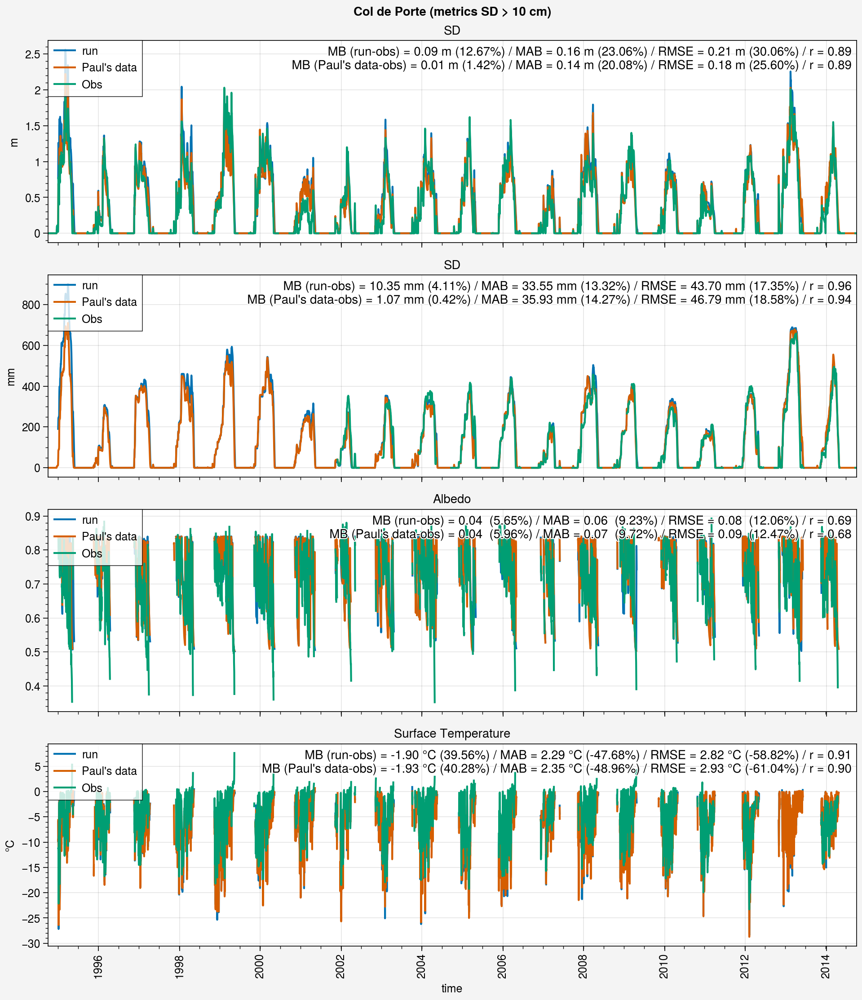

In [75]:
fig, axs = pplt.subplots(ncols=1, nrows=4, refaspect=4, refwidth=9, sharey=0)

##########
### SD ###
##########

# Plot
ax = axs[0]
h1 = ax.plot(ds_d.snd.squeeze(), label=label)
h2 = ax.plot(ds2_d.snd.squeeze(), label=label2)
h3 = ax.plot(ds_d_eval_menard2019.snd_auto, label='Obs')

# Metrics
obs = ds_d_eval_menard2019.snd_auto.where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.snd.where(ds_d.snd >= 0.1).squeeze()
simu2 = ds2_d.snd.where(ds2_d.snd >= 0.1).squeeze()

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = 'm'
ax.format(title='SD', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)


###########
### SWE ###
###########

# Plot
ax = axs[1]
h1 = ax.plot(ds_d.snw.squeeze(), label=label)
h2 = ax.plot(ds2_d.snw.squeeze(), label=label2)
h3 = ax.plot(ds_d_eval_menard2019.snw_auto, label='Obs')

# Metrics
obs = ds_d_eval_menard2019.snw_auto.where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.snw.where(ds_d.snd >= 0.1).squeeze()
simu2 = ds2_d.snw.where(ds2_d.snd >= 0.1).squeeze()

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = 'mm'
ax.format(title='SD', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)


##############
### Albedo ###
##############

# Plot
ax = axs[2]
h1 = ax.plot(ds_d.albsn.where(ds_d.snd >= 0.1).squeeze(), label=label)
h2 = ax.plot(ds2_d.albsn.where(ds2_d.snd >= 0.1).squeeze(), label=label2)
h3 = ax.plot(ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.albsn.where(ds_d.snd >= 0.1).squeeze()
simu2 = ds2_d.albsn.where(ds2_d.snd >= 0.1).squeeze()

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = ''
ax.format(title='Albedo', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)



##########
### TS ###
##########

# Plot
ax = axs[3]
h1 = ax.plot(ds_d.ts.where(ds_d.snd >= 0.1).squeeze()-273.15, label=label)
h2 = ax.plot(ds2_d.ts.where(ds2_d.snd >= 0.1).squeeze()-273.15, label=label2)
h3 = ax.plot(ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.ts.where(ds_d.snd >= 0.1).squeeze()-273.15
simu2 = ds2_d.ts.where(ds2_d.snd >= 0.1).squeeze()-273.15

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = '°C'
ax.format(title='Surface Temperature', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)


fig.suptitle('Col de Porte (metrics SD > 10 cm)')


